# Molar Angulation

Extraction des Informations à partir des Fichiers XML :

In [1]:
import pandas as pd
import xml.etree.ElementTree as ET
import glob
import os


_dir=r'C:\Users\hibat\Desktop\teeth\est'

os.chdir(_dir)

elements = ['Image','height','width','depth','coin_1','coin_2','coin_3','coin_4']

df=pd.DataFrame(columns=elements)

# Initialize empty lists to store coin information
coin_names = []
coin_values = {}


# Iterate over XML files in the directory
for xml_file in glob.glob('*.xml'):
    if xml_file.endswith('.xml'):
        # Parse the XML file
        tree = ET.parse(os.path.join(_dir, xml_file))
        root = tree.getroot()

        # Extract the annotation file name
        file_name = root.find('filename').text
        
        # Extract size information
        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)
        depth = int(root.find('size/depth').text)
        
        
        # Iterate over the 'object' elements
        for obj in root.iter('object'):
            # Extract the coin name
            coin_name = obj.find('name').text
            
            # Extract the coin value (xmin, ymin, xmax, ymax)
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Store the coin value in the dictionary
            coin_values[coin_name] = (xmin, xmax, ymin, ymax)
    
        tmp_df=pd.DataFrame([coin_values], columns=['Image','height','width','depth'] + list(coin_values.keys()))
        # Set the 'filename' column value
        tmp_df['Image'] = file_name
        tmp_df['height']=height
        tmp_df['width']=width
        tmp_df['depth']=depth
        # Append the data to the DataFrame
        df = pd.concat([df,tmp_df], ignore_index=True)
        


# Print the DataFrame
print(df.describe)

<bound method NDFrame.describe of      Image height width depth                coin_1                coin_2  \
0    0.jpg    448   448     3      (77, 77, 73, 73)    (17, 17, 245, 245)   
1    1.jpg    448   448     3    (89, 89, 167, 167)      (93, 93, 93, 93)   
2   10.jpg    448   448     3    (78, 78, 341, 341)    (20, 20, 186, 186)   
3   11.jpg    448   448     3    (69, 69, 340, 340)    (31, 31, 213, 213)   
4   12.jpg    448   448     3    (72, 72, 338, 338)    (32, 32, 209, 209)   
5   13.jpg    448   448     3    (74, 74, 277, 277)    (26, 26, 163, 163)   
6   14.jpg    448   448     3  (100, 100, 284, 284)    (42, 42, 169, 169)   
7   15.jpg    448   448     3    (87, 87, 256, 256)    (35, 35, 158, 158)   
8   16.jpg    448   448     3  (101, 101, 249, 249)    (39, 39, 147, 147)   
9   17.jpg    448   448     3    (66, 66, 262, 262)    (19, 19, 171, 171)   
10  18.jpg    448   448     3    (81, 81, 287, 287)    (28, 28, 196, 196)   
11  19.jpg    448   448     3    (72, 72, 

In [2]:
print([df[df[f'coin_{i}'].apply(lambda x: x[2]) != df[f'coin_{i}'].apply(lambda x: x[3])] for i in range(1,5)])
print(df[df.height<448])

[Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []]
Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []


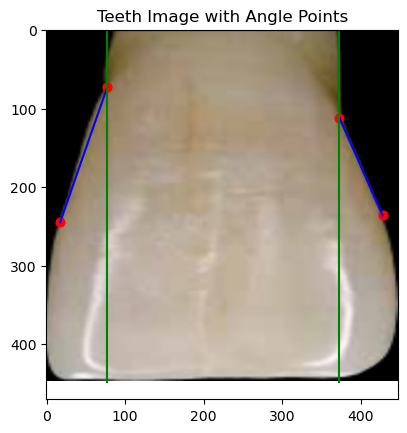

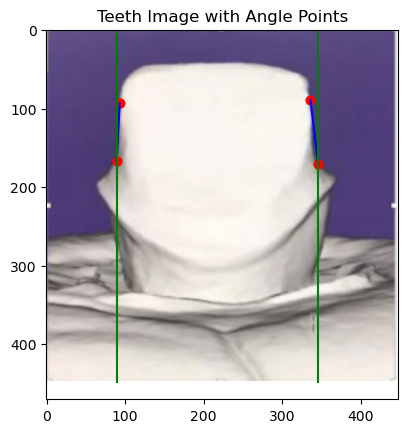

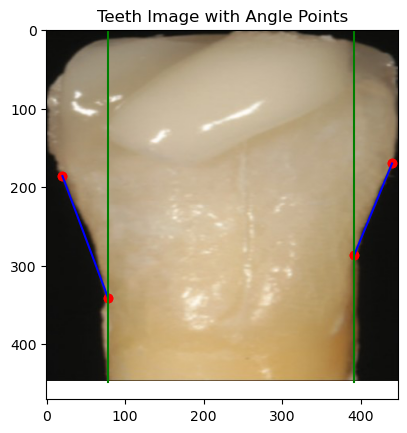

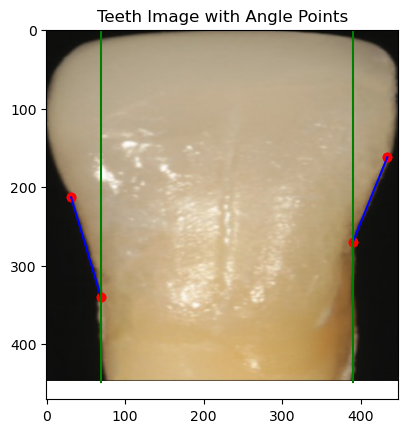

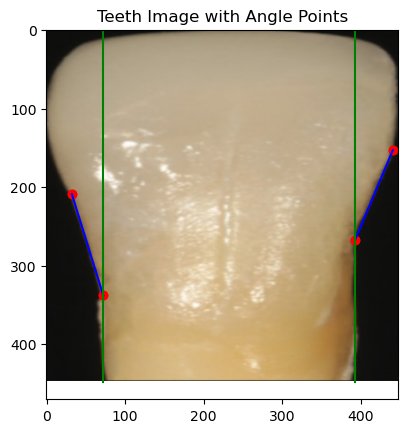

...

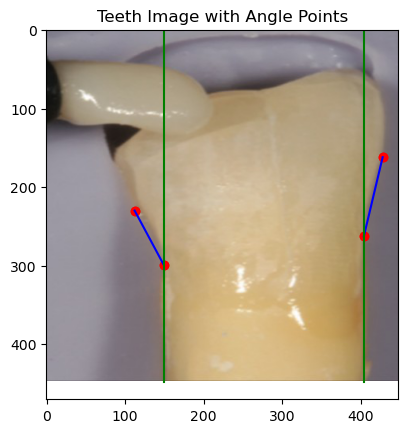

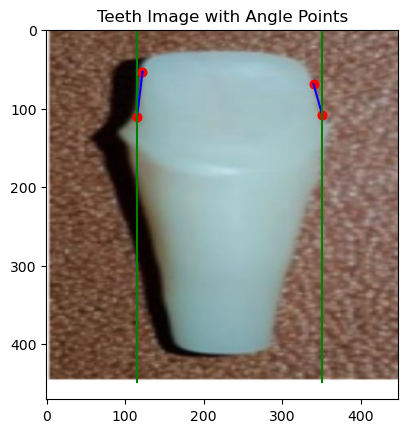

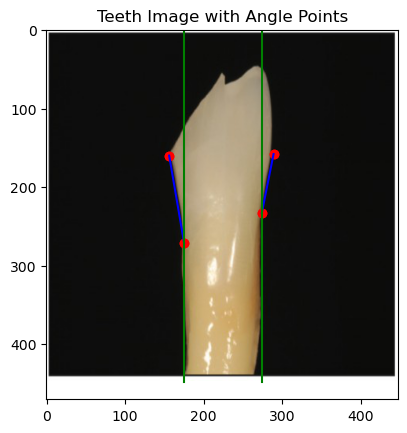

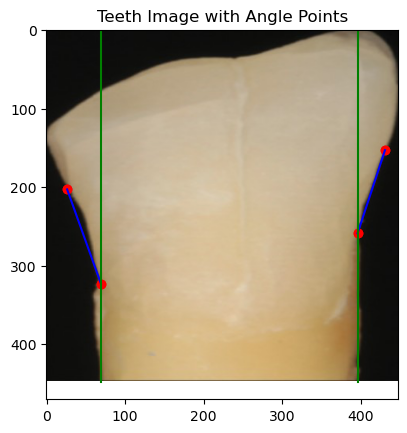

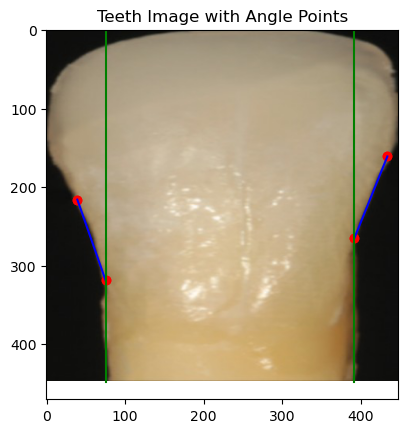

In [3]:
import matplotlib.pyplot as plt
import cv2

images=df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i,f'coin_{x}'] for x in range(1,5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    for p in angle:
        plt.scatter([p[0],p[1]], [p[2],p[3]], color='red')  # Plot the x and y coordinates separately
        # Draw a line between the two points
        plt.plot()
    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        x_c00rds = [angle[j][0],angle[j][0]]
        y_c00rds = [448,0]
        plt.plot(x_coords, y_coords, color='blue')
        plt.plot(x_c00rds, y_c00rds, color='green')
    plt.title('Teeth Image with Angle Points')
    plt.show()

In [4]:
import cv2
import numpy as np

images = df.Image
output_folder=_dir+'/masks'

# Set the output folder to save the resulting images
os.makedirs(output_folder, exist_ok=True)

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    mask = np.zeros_like(image)
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points and lines
    #for p in angle:
        #cv2.circle(mask, (p[0], p[2]), 3, (0, 0, 255), -1)  # Draw red circles at angle points

    # Draw lines between the angle points
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        cv2.line(mask, (x_coords[0], y_coords[0]), (x_coords[1], y_coords[1]), (255, 255, 255), 2)  # Draw blue lines

    # Prepare mask for augmentation
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)  # Convert mask to grayscale
    mask = np.expand_dims(mask, axis=-1)  # Add channel dimension
    
    # Save the resulting image
    output_path = os.path.join(output_folder, f'mask_{images[i][:-4]}.jpg')
    cv2.imwrite(output_path, mask)
    

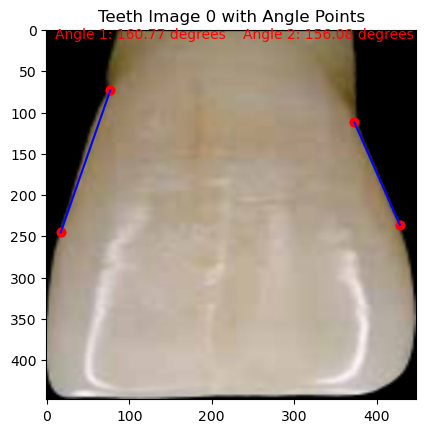

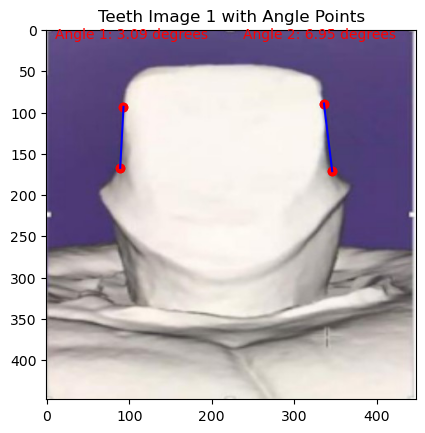

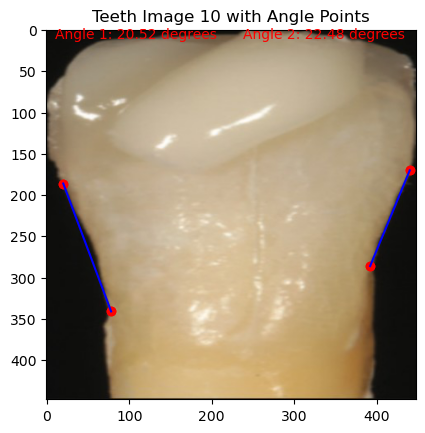

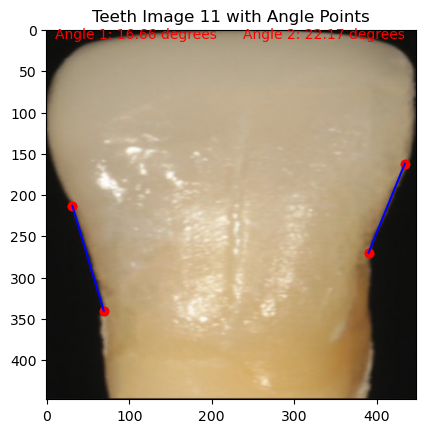

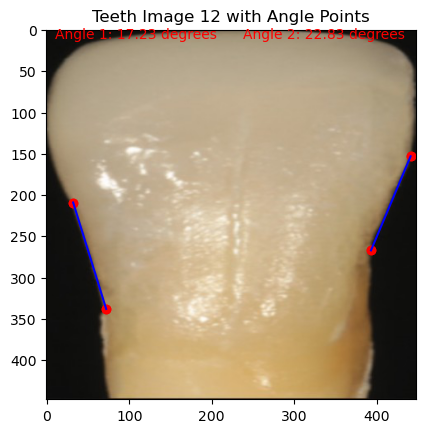

...

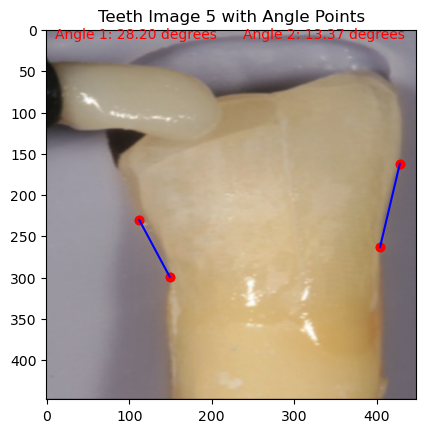

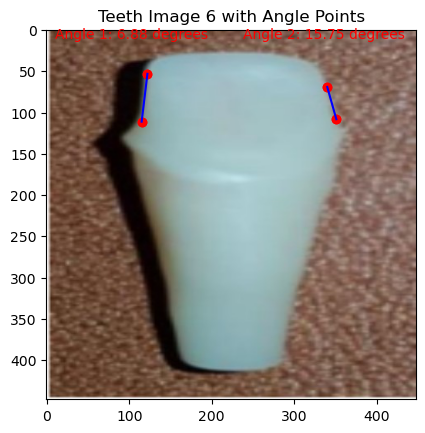

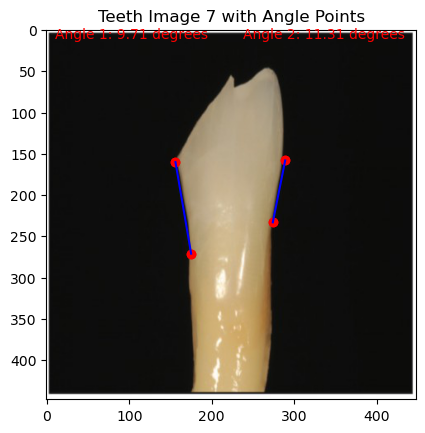

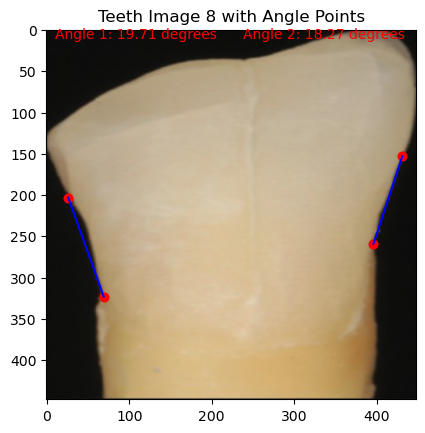

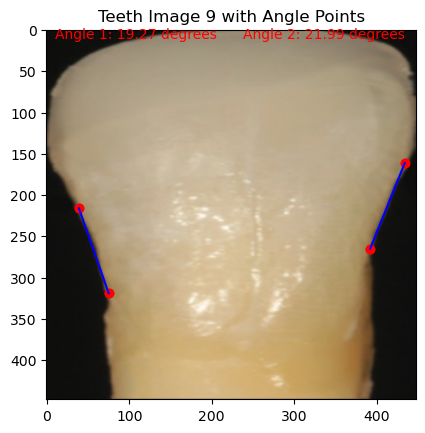

In [5]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

images = df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Plot scatter points
    for p in angle:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')

    angs=[]
        
    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        plt.plot(x_coords, y_coords, color='blue')

        # Calculate angle between two lines
        # Define the starting points of the two lines
        line1_start = np.array([angle[j][0], angle[j][2]])
        line2_start = np.array([angle[j+1][0], 448])

        # Define the ending points of the two lines
        line1_end = np.array([angle[j+1][0], angle[j+1][2]])
        line2_end = np.array([angle[j+1][0], 0])
    
        # Calculate the direction vectors of the two lines
        line1_vector = line1_end - line1_start
        line2_vector = line2_end - line2_start

        dot_product = np.dot(line1_vector, line2_vector)
        magnitude_product = np.linalg.norm(line1_vector) * np.linalg.norm(line2_vector)
        angle_rad = np.arccos(dot_product / magnitude_product)
        angle_deg = np.degrees(angle_rad)
        angs.append(angle_deg)

    plt.title(f'Teeth Image {images[i][:-4]} with Angle Points')
    plt.text(10, 10, f'Angle 1: {angs[0]:.2f} degrees', color='red') if angs[0] < 180 else  plt.text(10, 10, f'Angle: {angs[0]-360:.2f} degrees', color='red')
    plt.text(238, 10, f'Angle 2: {angs[1]:.2f} degrees', color='red') if angs[1] < 180 else  plt.text(10, 10, f'Angle: {angs[1]-360:.2f} degrees', color='red')
    #df.loc[i, 'Angle 1'] = angs[0] if angs[0] < 180 else angs[0]-180
    #df.loc[i, 'Angle 2'] = angs[1] if angs[1] < 180 else angs[1]-180
    plt.show()

In [6]:
import cv2
import matplotlib.pyplot as plt

# Load images and masks
images = []
masks = []


for im in df.Image:
    mask_path = f'masks/mask_{im[:-4]}.jpg'

    image = cv2.imread(im)
    mask = cv2.imread(mask_path)

    images.append(image)
    masks.append(mask)

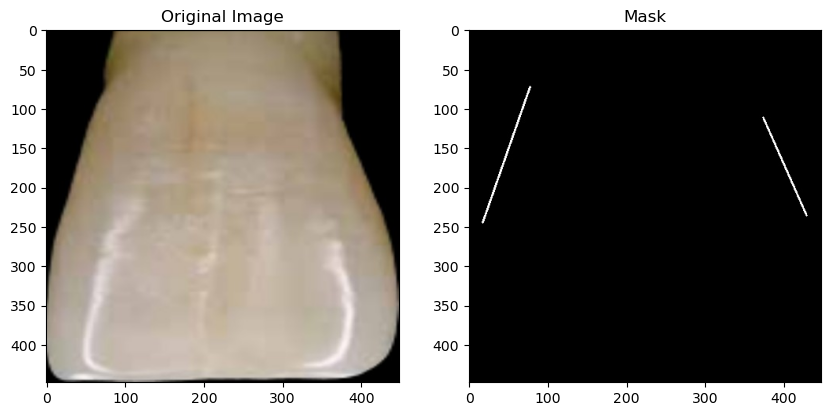

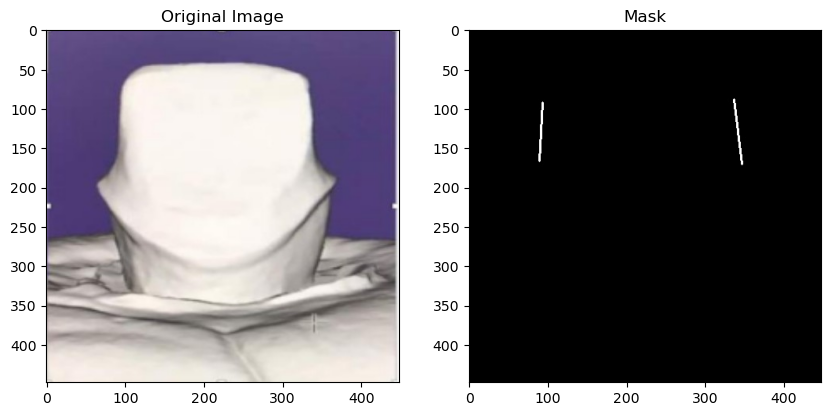

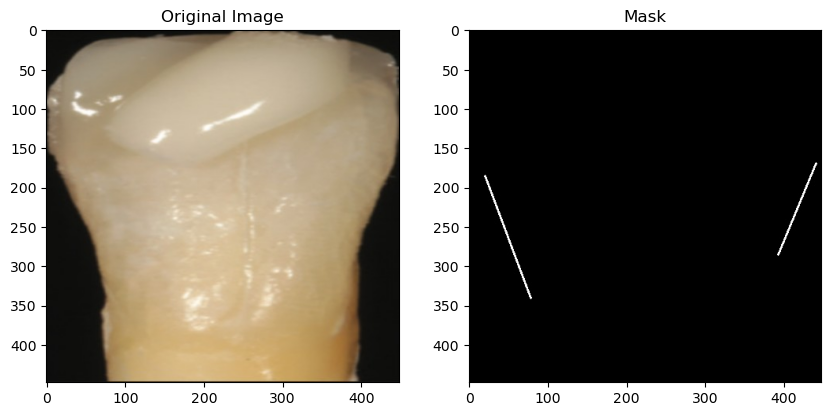

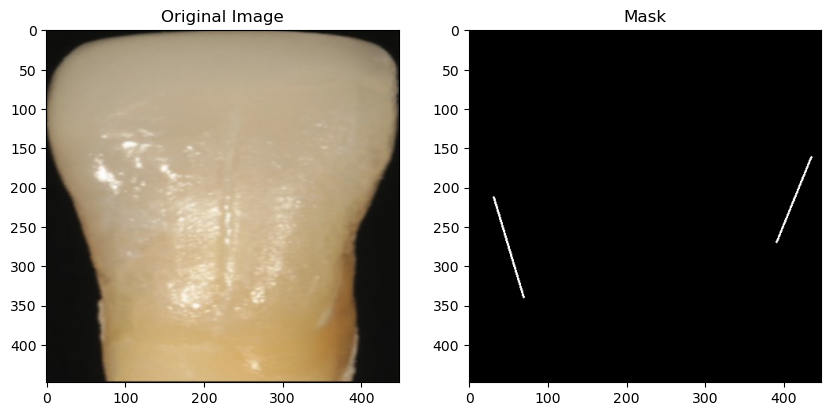

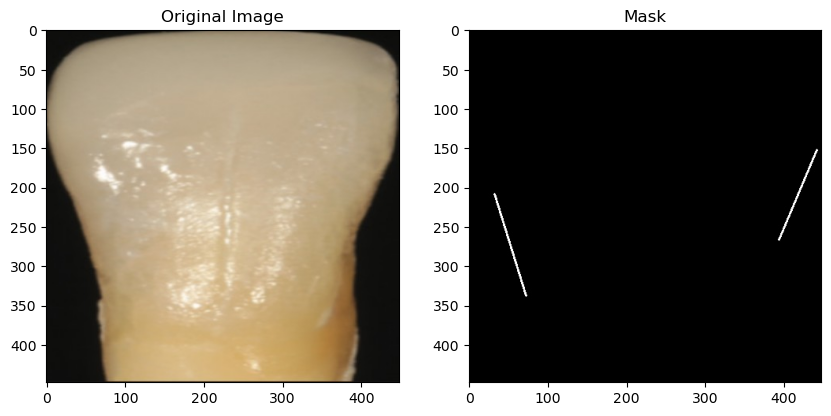

...

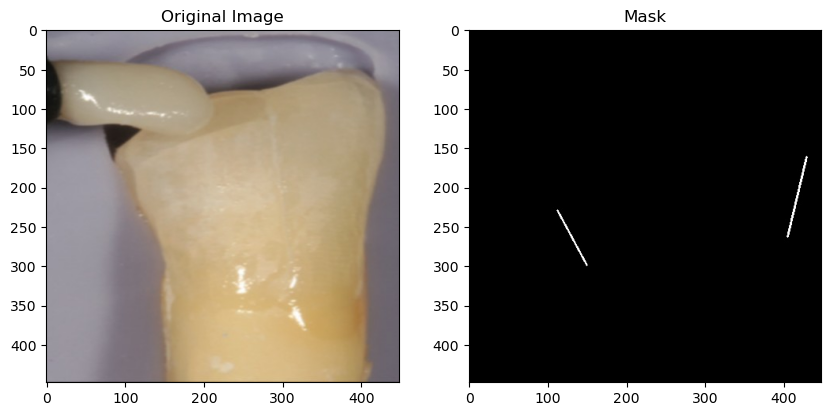

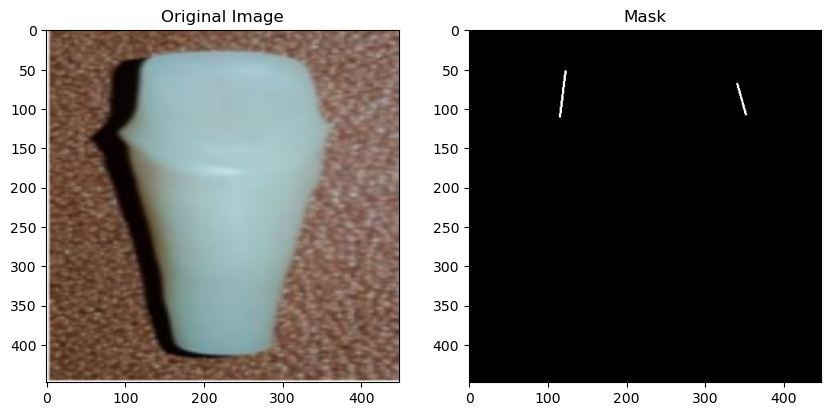

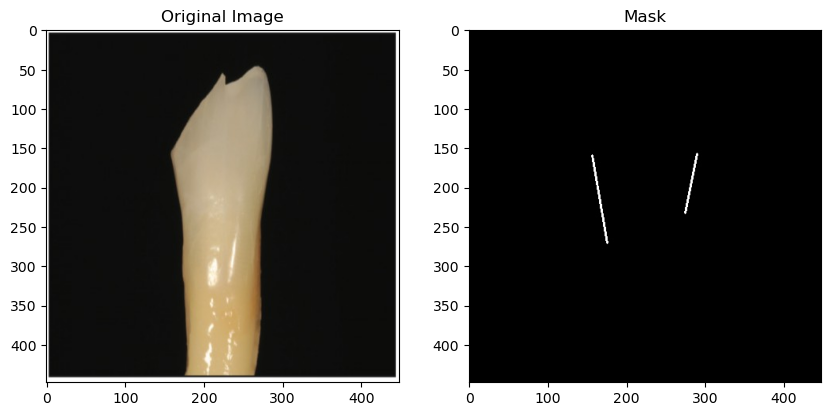

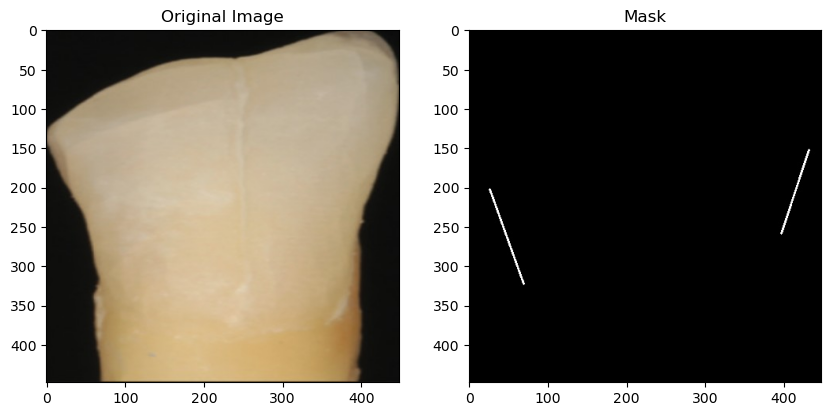

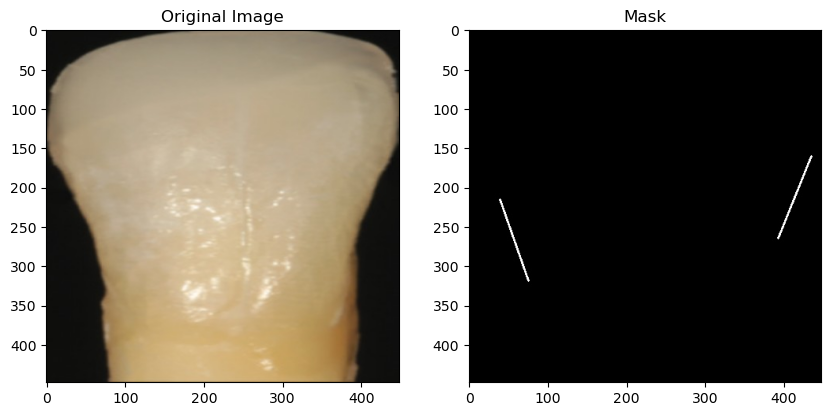

In [7]:
# Display images and masks side by side
for image, mask in zip(images, masks):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Display the original image
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')

    # Display the mask
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Mask')

    plt.show()

Initialisation du Générateur d'Images 

In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an image data generator with desired augmentations
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='constant',
    cval=0
)

# Generate augmented images and masks
augmented_images = []
augmented_masks = []

for image, mask in zip(images, masks):
    image_batch = np.expand_dims(image, axis=0)
    mask_batch = np.expand_dims(mask, axis=0)

    # Apply data augmentation to images
    augmented_image_batch = data_generator.flow(image_batch, batch_size=1, shuffle=False)

    # Apply data augmentation to masks (use the same seed for consistency)
    augmented_mask_batch = data_generator.flow(mask_batch, batch_size=1, shuffle=False)

    augmented_image = next(augmented_image_batch)[0]
    augmented_mask = next(augmented_mask_batch)[0]

    augmented_images.append(augmented_image)
    augmented_masks.append(augmented_mask)

augmented_images = np.array(augmented_images)
augmented_masks = np.array(augmented_masks)

# Check the shapes of augmented images and masks
print(f'Augmented Images Size : {augmented_images.size}, Shape : {augmented_images.shape}')
print(f'Augmented Masks Size : {augmented_masks.size}, Shape : {augmented_masks.shape}')

Augmented Images Size : 28901376, Shape : (48, 448, 448, 3)
Augmented Masks Size : 28901376, Shape : (48, 448, 448, 3)


In [101]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def build_unet1(input_shape):
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    # Decoder
    up2 = UpSampling2D(size=(2, 2))(pool1)
    up2 = Conv2D(64, 2, activation='relu', padding='same')(up2)
    merge2 = concatenate([conv1, up2], axis=3)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(merge2)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(conv2)

    outputs = Conv2D(1, 1, activation='sigmoid')(conv2)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Build the U-Net model
input_shape = images[0].shape
model = build_unet(input_shape)

# Modify the masks to have a single channel
augmented_masks_single_channel = augmented_masks[..., 0:1]

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy')

# Train the model
model.fit(augmented_images, augmented_masks_single_channel, batch_size=8, epochs=10, validation_split=0.2)

Epoch 1/10
5/5 [==============================] - 434s 83s/step - loss: 8.1781 - val_loss: 4.4443
Epoch 2/10
5/5 [==============================] - 381s 76s/step - loss: 2.4653 - val_loss: 3.3567
Epoch 3/10
5/5 [==============================] - 379s 77s/step - loss: 1.5102 - val_loss: 1.1518
Epoch 4/10
5/5 [==============================] - 390s 79s/step - loss: 0.7155 - val_loss: 0.9183
Epoch 5/10
5/5 [==============================] - 384s 75s/step - loss: 0.6190 - val_loss: 0.7720
Epoch 6/10
5/5 [==============================] - 372s 74s/step - loss: 0.4876 - val_loss: 1.1563
Epoch 7/10
5/5 [==============================] - 379s 76s/step - loss: 0.2955 - val_loss: 1.4839
Epoch 8/10
5/5 [==============================] - 376s 75s/step - loss: -0.0531 - val_loss: 2.0707
Epoch 9/10
5/5 [==============================] - 378s 75s/step - loss: -1.3355 - val_loss: 4.5477
Epoch 10/10
5/5 [==============================] - 367s 74s/step - loss: -4.3945 - val_loss: 8.2508


In [121]:
# Perform inference on new images
new_image_path = '23.jpg'
new_image = cv2.imread(new_image_path)

# Preprocess the new image
new_image = np.expand_dims(new_image, axis=0)

# Predict line mask
line_mask = model.predict(new_image)

# Threshold the line mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Perform post-processing if needed (e.g., morphological operations or line fitting)

# Visualize the line mask
cv2.imshow("Line Mask", thresholded_mask[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 1s 794ms/step


In [12]:
from sklearn.model_selection import train_test_split


# Modify the masks to have a single channel
augmented_masks_single_channel = augmented_masks[..., 0:1]
# Split the augmented data into training and validation sets
train_images, val_images, train_masks, val_masks = train_test_split(augmented_images, augmented_masks_single_channel, test_size=0.2, random_state=42)

In [140]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate

def unet_model(input_shape):
    inputs = Input(input_shape)

    # Encoding path
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    # Add more convolutional and pooling layers as needed

    # Decoding path
    up6 = UpSampling2D(size=(2, 2))(pool1)
    merge6 = Concatenate(axis=3)([conv1, up6])
    conv6 = Conv2D(2, 3, activation='relu', padding='same')(merge6)
    # Add more upsampling and concatenation layers as needed

    # Output
    outputs = Conv2D(1, 1, activation='sigmoid')(conv6)

    model = Model(inputs=inputs, outputs=outputs)
    return model


# Build the U-Net model
input_shape = images[0].shape
model = build_unet(input_shape)

In [10]:
# Build the U-Net model
input_shape = images[0].shape
model = unet_model_3(input_shape)

In [13]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy')
# Train the model
model.fit(train_images, train_masks, batch_size=8, epochs=10, validation_data=(val_images, val_masks))

Epoch 1/10
5/5 [==============================] - 800s 156s/step - loss: 13.7868 - val_loss: 4.4972
Epoch 2/10
5/5 [==============================] - 768s 153s/step - loss: 2.0566 - val_loss: 0.8689
Epoch 3/10
5/5 [==============================] - 747s 150s/step - loss: 0.7223 - val_loss: 0.6419
Epoch 4/10
5/5 [==============================] - 733s 146s/step - loss: 0.7820 - val_loss: 0.7556
Epoch 5/10
5/5 [==============================] - 730s 147s/step - loss: 0.6069 - val_loss: 0.5682
Epoch 6/10
5/5 [==============================] - 725s 146s/step - loss: 0.5923 - val_loss: 0.2698
Epoch 7/10
5/5 [==============================] - 751s 151s/step - loss: 0.3215 - val_loss: -1.2952
Epoch 8/10
5/5 [==============================] - 743s 150s/step - loss: -10.8067 - val_loss: -54.4595
Epoch 9/10
5/5 [==============================] - 745s 148s/step - loss: 256.2889 - val_loss: -21.6816
Epoch 10/10
5/5 [==============================] - 738s 148s/step - loss: -21.5572 - val_loss: -31.

In [14]:
# Evaluate the model
eval_loss = model.evaluate(val_images, val_masks)
print("Evaluation Loss:", eval_loss)

1/1 [==============================] - 40s 40s/step - loss: -31.2829
Evaluation Loss: -31.282934188842773


In [22]:
# Perform inference on new images
new_image_path = '3.jpg'
new_image = cv2.imread(new_image_path)

# Preprocess the new image
new_image = np.expand_dims(new_image, axis=0)

# Predict line mask
line_mask = model.predict(new_image)

# Threshold the line mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Perform post-processing if needed (e.g., morphological operations or line fitting)

# Visualize the line mask
cv2.imshow("Line Mask", thresholded_mask[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 4s 4s/step


In [9]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, UpSampling2D, Concatenate, Activation

def unet_model_3(input_shape):
    # Encoder
    inputs = Input(shape=input_shape)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    
    # Middle
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    
    # Decoder
    up4 = UpSampling2D(size=(2, 2))(conv3)
    up4 = Conv2D(128, 2, activation='relu', padding='same')(up4)
    concat4 = Concatenate(axis=-1)([conv2, up4])
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)
    
    up5 = UpSampling2D(size=(2, 2))(conv4)
    up5 = Conv2D(64, 2, activation='relu', padding='same')(up5)
    concat5 = Concatenate(axis=-1)([conv1, up5])
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(concat5)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)
    
    # Output layer for the mask with two straight lines
    output_channels = 1  # Number of channels in the output mask
    output_activation = 'sigmoid'  # Activation function for the output mask
    output_layer = Conv2D(output_channels, (1, 1))(conv5)
    output_layer = Activation(output_activation)(output_layer)
    
    # Create the model
    model = Model(inputs=inputs, outputs=output_layer)
    
    return model